# Filtering: Capstone Two

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [2]:
df_noisy = pd.read_csv('D:\\Springboard\\Technical Project\\7_Capstone Two\\data\\noisy_data.csv', index_col=0)
df_noisy['date']=pd.to_datetime(df_noisy['date'])
df_noisy.head()

,sequence_name,tag_position,date,x_coord,y_coord,z_coord,activity,vx,vy,vz
7,A01,Ankle_Left,2009-05-27 14:03:25.343,3.958496,1.703563,0.511041,walking,-1.220181,-1.664489,0.415641
9,A01,Ankle_Left,2009-05-27 14:03:25.453,4.016991,1.734065,0.193167,walking,0.531769,0.277292,-2.889769
13,A01,Ankle_Left,2009-05-27 14:03:25.560,3.748375,2.073422,0.254482,walking,-2.510430,3.171565,0.573036
15,A01,Ankle_Left,2009-05-27 14:03:25.670,3.820894,2.049378,0.055377,walking,0.659266,-0.218586,-1.810044
19,A01,Ankle_Left,2009-05-27 14:03:25.777,4.039506,1.908465,0.453817,walking,2.043107,-1.316940,3.723740


In [3]:
df_noisy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161314 entries, 7 to 164857
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   sequence_name  161314 non-null  object        
 1   tag_position   161314 non-null  object        
 2   date           161314 non-null  datetime64[ns]
 3   x_coord        161314 non-null  float64       
 4   y_coord        161314 non-null  float64       
 5   z_coord        161314 non-null  float64       
 6   activity       161314 non-null  object        
 7   vx             161314 non-null  float64       
 8   vy             161314 non-null  float64       
 9   vz             161314 non-null  float64       
dtypes: datetime64[ns](1), float64(6), object(3)
memory usage: 13.5+ MB


In [4]:
# Create a function that calculates dt
def deltat(df):
    dt = (pd.to_numeric(df['date'].diff())/1e9) # calculating dt
    df_dt = pd.DataFrame({'dt':dt})
    return df_dt

In [5]:
# Modify the dataframe with dt as column
df_dt = pd.DataFrame()
for i in df_noisy['sequence_name'].unique():
    for k in df_noisy['tag_position'].unique():
        df1 = df_noisy[(df_noisy['sequence_name']==i) & (df_noisy['tag_position']==k)]
        df_dt = df_dt.append(pd.concat([df1, deltat(df1)], axis=1))

In [6]:
df_dt.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161314 entries, 7 to 164857
Data columns (total 11 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   sequence_name  161314 non-null  object        
 1   tag_position   161314 non-null  object        
 2   date           161314 non-null  datetime64[ns]
 3   x_coord        161314 non-null  float64       
 4   y_coord        161314 non-null  float64       
 5   z_coord        161314 non-null  float64       
 6   activity       161314 non-null  object        
 7   vx             161314 non-null  float64       
 8   vy             161314 non-null  float64       
 9   vz             161314 non-null  float64       
 10  dt             161314 non-null  float64       
dtypes: datetime64[ns](1), float64(7), object(3)
memory usage: 14.8+ MB


In [7]:
df_dt.head()

,sequence_name,tag_position,date,x_coord,y_coord,z_coord,activity,vx,vy,vz,dt
7,A01,Ankle_Left,2009-05-27 14:03:25.343,3.958496,1.703563,0.511041,walking,-1.220181,-1.664489,0.415641,-9.223372e+09
9,A01,Ankle_Left,2009-05-27 14:03:25.453,4.016991,1.734065,0.193167,walking,0.531769,0.277292,-2.889769,1.100000e-01
13,A01,Ankle_Left,2009-05-27 14:03:25.560,3.748375,2.073422,0.254482,walking,-2.510430,3.171565,0.573036,1.070000e-01
15,A01,Ankle_Left,2009-05-27 14:03:25.670,3.820894,2.049378,0.055377,walking,0.659266,-0.218586,-1.810044,1.100000e-01
19,A01,Ankle_Left,2009-05-27 14:03:25.777,4.039506,1.908465,0.453817,walking,2.043107,-1.316940,3.723740,1.070000e-01


In [8]:
# Drop the absurd values
df_dt.drop(index=df_dt[df_dt['dt']<=-1e6].index, inplace=True)

In [9]:
df_dt.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161214 entries, 9 to 164857
Data columns (total 11 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   sequence_name  161214 non-null  object        
 1   tag_position   161214 non-null  object        
 2   date           161214 non-null  datetime64[ns]
 3   x_coord        161214 non-null  float64       
 4   y_coord        161214 non-null  float64       
 5   z_coord        161214 non-null  float64       
 6   activity       161214 non-null  object        
 7   vx             161214 non-null  float64       
 8   vy             161214 non-null  float64       
 9   vz             161214 non-null  float64       
 10  dt             161214 non-null  float64       
dtypes: datetime64[ns](1), float64(7), object(3)
memory usage: 14.8+ MB


In [10]:
df_dt.head()

,sequence_name,tag_position,date,x_coord,y_coord,z_coord,activity,vx,vy,vz,dt
9,A01,Ankle_Left,2009-05-27 14:03:25.453,4.016991,1.734065,0.193167,walking,0.531769,0.277292,-2.889769,0.110
13,A01,Ankle_Left,2009-05-27 14:03:25.560,3.748375,2.073422,0.254482,walking,-2.510430,3.171565,0.573036,0.107
15,A01,Ankle_Left,2009-05-27 14:03:25.670,3.820894,2.049378,0.055377,walking,0.659266,-0.218586,-1.810044,0.110
19,A01,Ankle_Left,2009-05-27 14:03:25.777,4.039506,1.908465,0.453817,walking,2.043107,-1.316940,3.723740,0.107
21,A01,Ankle_Left,2009-05-27 14:03:25.883,4.030049,1.924634,0.490846,walking,-0.089218,0.152537,0.349329,0.106


In [11]:
# Review the summary statistics of numerical columns
df_dt.describe()

,x_coord,y_coord,z_coord,vx,vy,vz,dt
count,161214.000000,161214.000000,161214.000000,161214.000000,161214.000000,161214.000000,161214.000000
mean,2.819524,1.695855,0.411273,0.003307,0.000333,0.001621,0.135263
std,0.902475,0.464844,0.361676,1.650501,1.460702,1.398467,0.083247
min,-0.278698,-0.494428,-1.970227,-22.303531,-18.406799,-19.238298,0.013000
25%,2.179072,1.351127,0.171915,-0.341327,-0.414975,-0.506958,0.107000
50%,2.884701,1.631742,0.364592,0.000499,-0.000735,0.002792,0.110000
75%,3.412209,2.035794,0.603930,0.347535,0.415904,0.509029,0.110000
max,5.758173,3.965353,2.435000,22.592591,17.599071,20.316718,4.540000


In [12]:
# Define a function for Kalman Filtering
def KalmanFilter(df, pos_col, vel_col, dt_col):
    x_post = np.array([df[pos_col].iloc[0], df[vel_col].iloc[0]]).reshape(2,1) # Initialize the state
    P_post = np.array([[.0225, .0225*.09],[.0225*.09, .09]]) # Initialize the Process Error
    R = np.array([[.0225, .0225*.09],[.0225*.09, .09]]) # Define Measurement Error Covariance Matrix
    I = np.array([[1,0], [0,1]]) # Define Identity Matrix
    x = list(x_post[0])
    v = list(x_post[1])
    for i in range(1, len(df)):
        del_t = df[dt_col].iloc[i] # Define dt
        F = np.array([[1, del_t],[0,1]])
        Q = np.array([[.25*(del_t**4)*.0009, .5*(del_t**3)*.0009],[.5*(del_t**3)*.0009, (del_t**2)*.0009]])
        x_pred = np.dot(F, x_post) # Predict state
        P_pred = np.dot(np.dot(F, P_post), F.T) + Q # Predict Process Noise
        z = np.array([df[pos_col].iloc[i], df[vel_col].iloc[i]]).reshape(2,1) # Define measured matrix
        y_dilda = z - x_pred # Calculating residual matrix
        K = np.dot(P_pred, np.linalg.inv(R + P_pred)) # Calculating Kalman Gain
        x_post = x_pred + np.dot(K, y_dilda) # Update the state estimate
        x.append(x_post[0].item()) # Append in list of position
        v.append(x_post[1].item()) # Append in list of velocity
        P_post = np.dot((I - K), P_pred) # Update the process noise
    df1 = pd.DataFrame({pos_col+'_filtered':x, vel_col+'_filtered':v})
    df1.set_index(df.index, inplace=True)
    return df1

In [13]:
# Applying Kalman Filter to dataframe
df_clean = pd.DataFrame()
for i in df_dt['sequence_name'].unique():
    for k in df_dt['tag_position'].unique():
        df1 = df_dt[(df_dt['sequence_name']==i) & (df_dt['tag_position']==k)]
        df_clean = df_clean.append(pd.concat([df1, KalmanFilter(df1, 'x_coord', 'vx', 'dt'), 
                                                   KalmanFilter(df1, 'y_coord', 'vy', 'dt'), 
                                                   KalmanFilter(df1, 'z_coord', 'vz', 'dt')], axis=1))

In [14]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161214 entries, 9 to 164857
Data columns (total 17 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   sequence_name     161214 non-null  object        
 1   tag_position      161214 non-null  object        
 2   date              161214 non-null  datetime64[ns]
 3   x_coord           161214 non-null  float64       
 4   y_coord           161214 non-null  float64       
 5   z_coord           161214 non-null  float64       
 6   activity          161214 non-null  object        
 7   vx                161214 non-null  float64       
 8   vy                161214 non-null  float64       
 9   vz                161214 non-null  float64       
 10  dt                161214 non-null  float64       
 11  x_coord_filtered  161214 non-null  float64       
 12  vx_filtered       161214 non-null  float64       
 13  y_coord_filtered  161214 non-null  float64       
 14  vy_f

In [15]:
df_clean.head()

,sequence_name,tag_position,date,x_coord,y_coord,z_coord,activity,vx,vy,vz,dt,x_coord_filtered,vx_filtered,y_coord_filtered,vy_filtered,z_coord_filtered,vz_filtered
9,A01,Ankle_Left,2009-05-27 14:03:25.453,4.016991,1.734065,0.193167,walking,0.531769,0.277292,-2.889769,0.110,4.016991,0.531769,1.734065,0.277292,0.193167,-2.889769
13,A01,Ankle_Left,2009-05-27 14:03:25.560,3.748375,2.073422,0.254482,walking,-2.510430,3.171565,0.573036,0.107,3.828994,-0.999414,1.996723,1.734022,0.162716,-1.146888
15,A01,Ankle_Left,2009-05-27 14:03:25.670,3.820894,2.049378,0.055377,walking,0.659266,-0.218586,-1.810044,0.110,3.812251,-0.454163,2.071353,1.089579,0.020249,-1.356480
19,A01,Ankle_Left,2009-05-27 14:03:25.777,4.039506,1.908465,0.453817,walking,2.043107,-1.316940,3.723740,0.107,3.933596,0.169504,2.020375,0.486483,0.225701,-0.085057
21,A01,Ankle_Left,2009-05-27 14:03:25.883,4.030049,1.924634,0.490846,walking,-0.089218,0.152537,0.349329,0.106,3.960349,0.135383,2.024298,0.403346,0.298244,0.036066


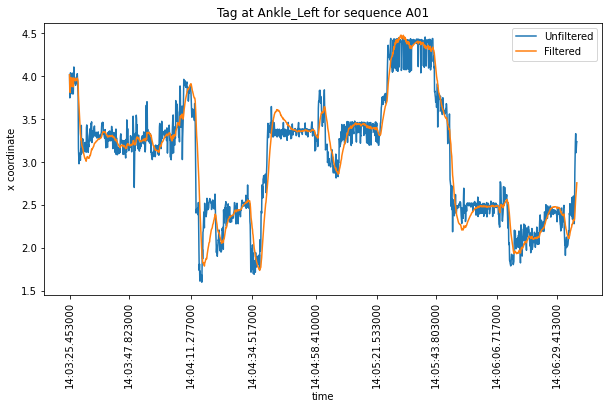

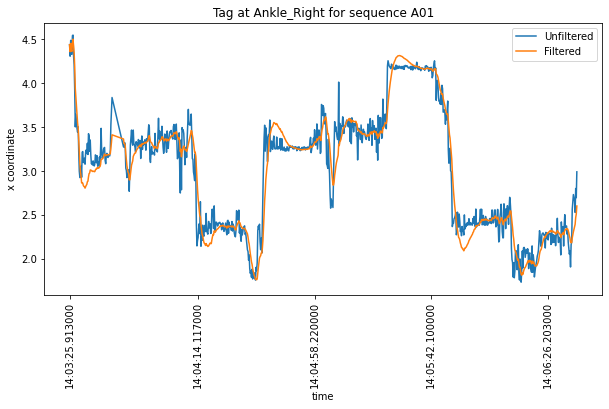

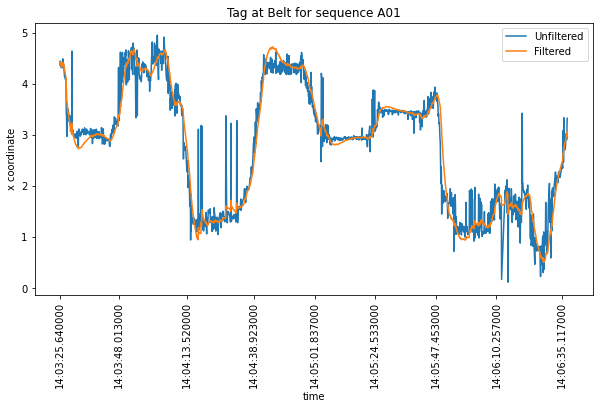

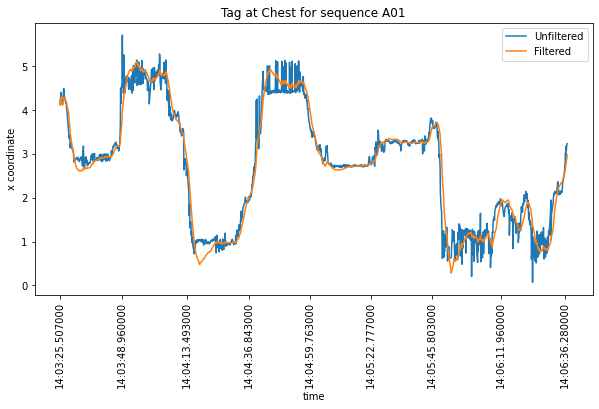

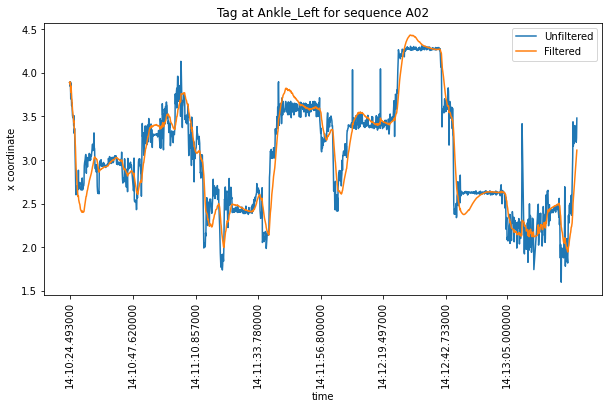

...

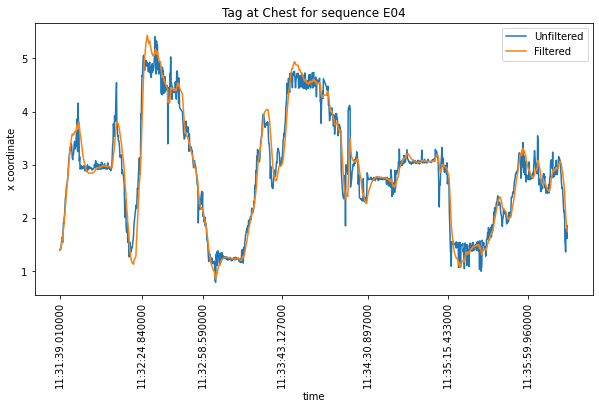

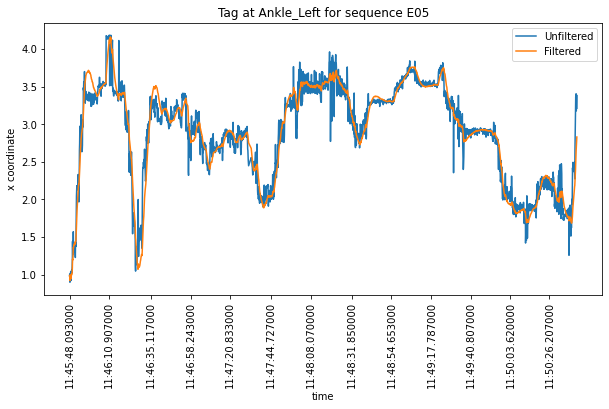

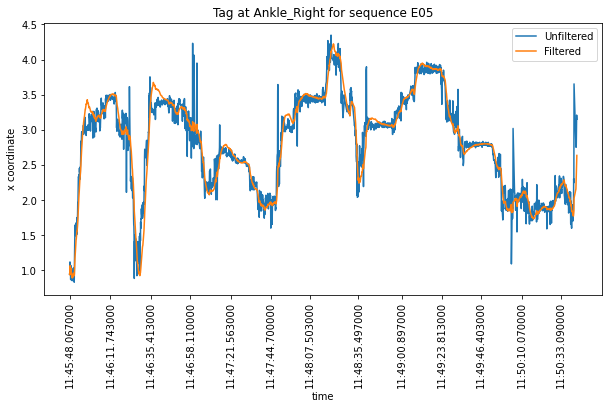

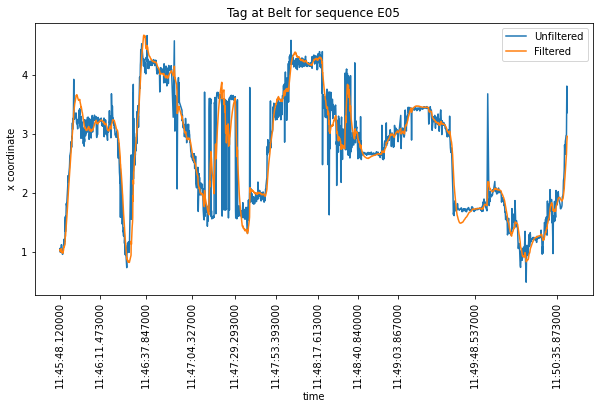

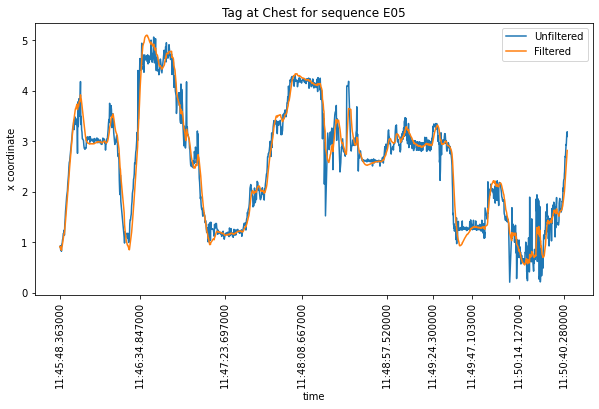

In [16]:
#Plotting the unfiltered and filtered data x coordinate
for i in df_clean.sequence_name.unique():
    for j in df_clean.tag_position.unique():
        plt.subplots(figsize=(10, 5))
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').x_coord, label='Unfiltered')
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').x_coord_filtered, label='Filtered')
        _ = plt.xlabel('time')
        _ = plt.ylabel('x coordinate')
        _ = plt.title(label=('Tag at '+j+' for sequence '+i))
        xt = df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date[::200]
        xtl = xt.dt.strftime('%H:%M:%S.%f')
        _ = plt.xticks(xt, xtl, rotation=90)
        _ = plt.legend()
        plt.show()

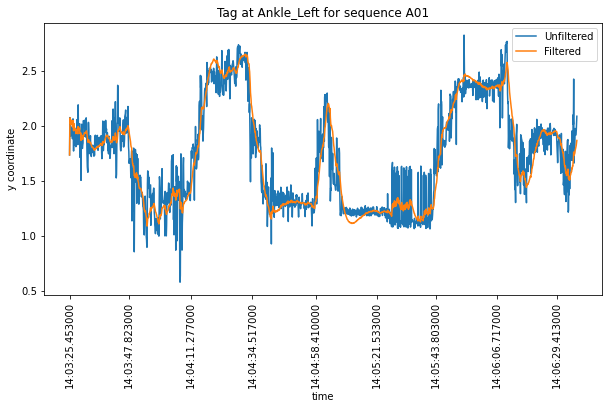

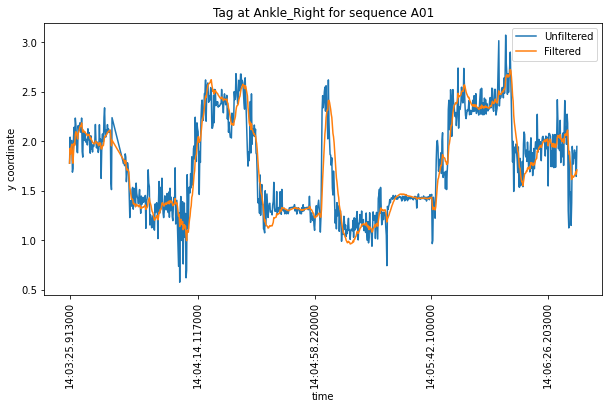

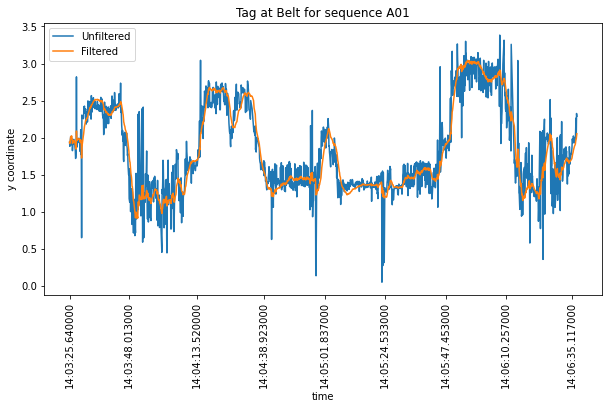

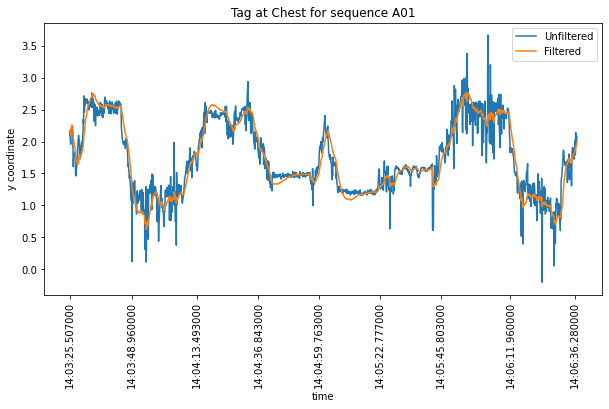

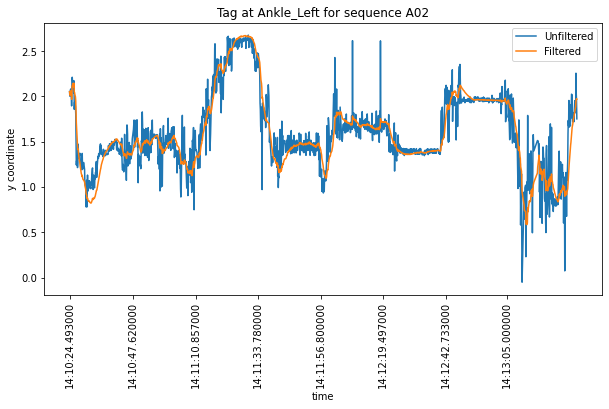

...

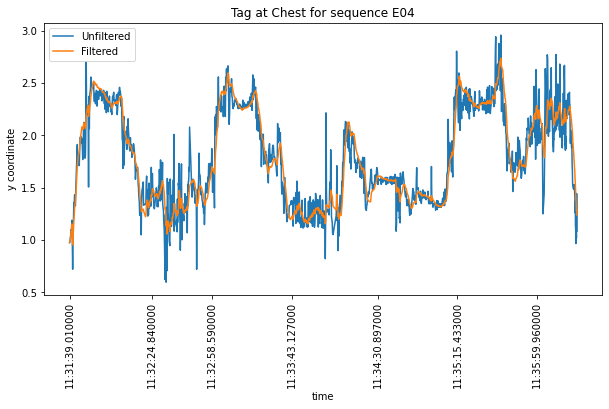

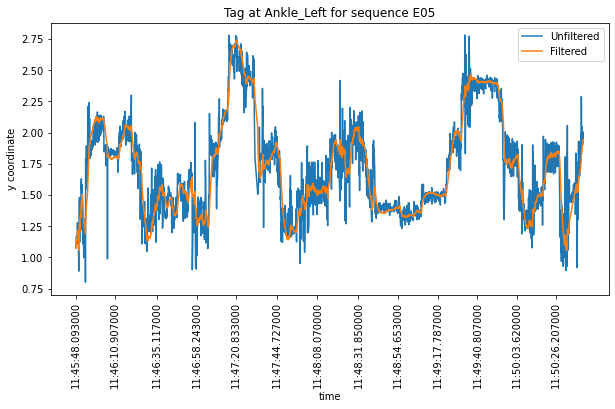

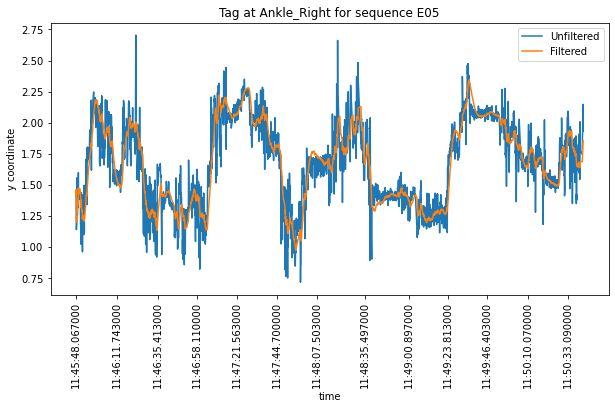

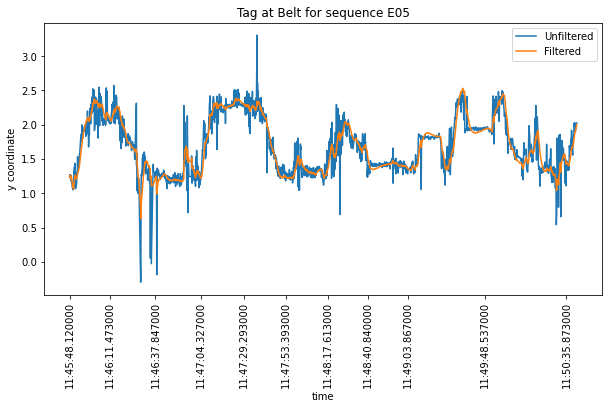

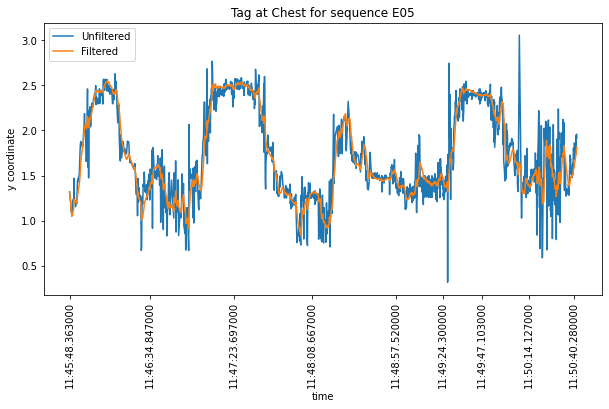

In [17]:
#Plotting the unfiltered and filtered data y coordinate
for i in df_clean.sequence_name.unique():
    for j in df_clean.tag_position.unique():
        plt.subplots(figsize=(10, 5))
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').y_coord, label='Unfiltered')
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').y_coord_filtered, label='Filtered')
        _ = plt.xlabel('time')
        _ = plt.ylabel('y coordinate')
        _ = plt.title(label=('Tag at '+j+' for sequence '+i))
        xt = df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date[::200]
        xtl = xt.dt.strftime('%H:%M:%S.%f')
        _ = plt.xticks(xt, xtl, rotation=90)
        _ = plt.legend()
        plt.show()

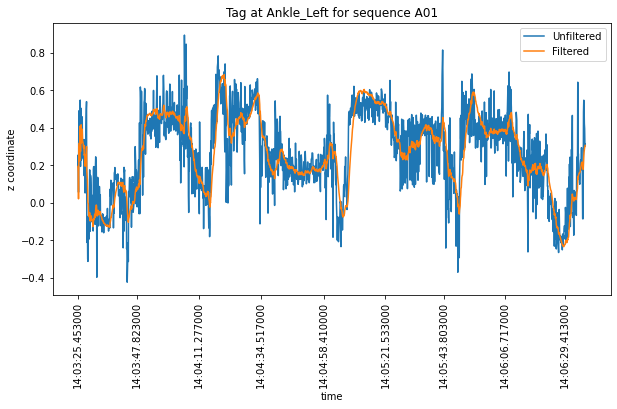

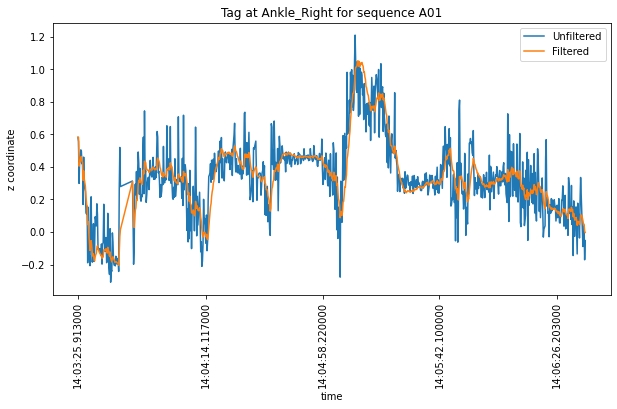

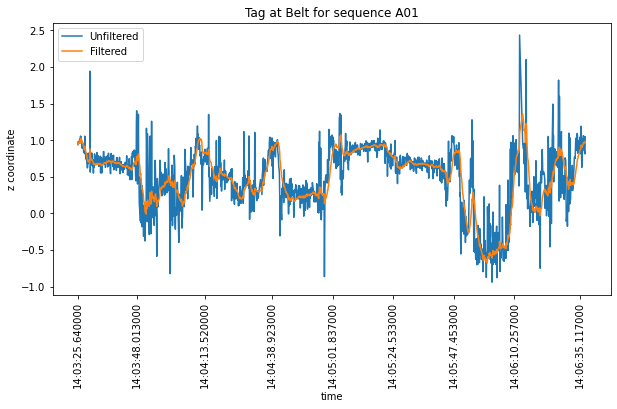

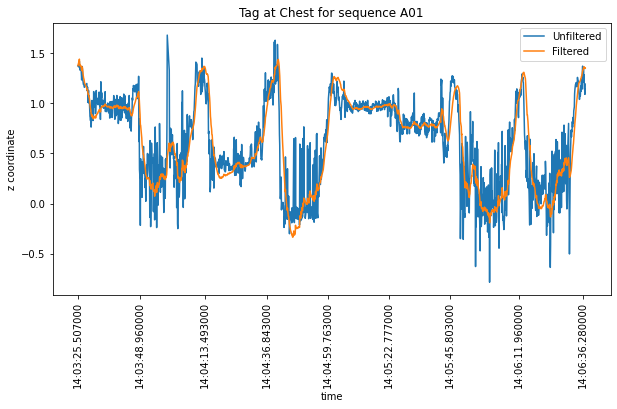

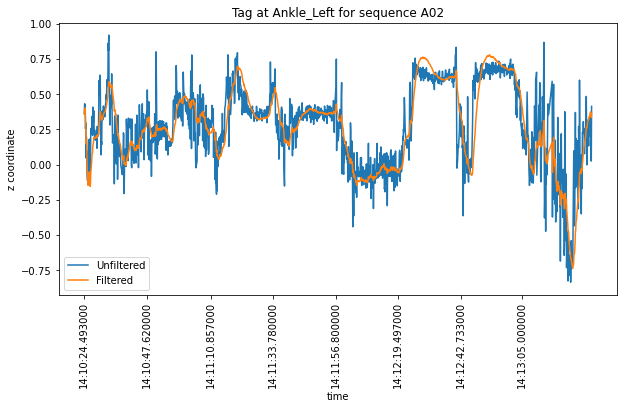

...

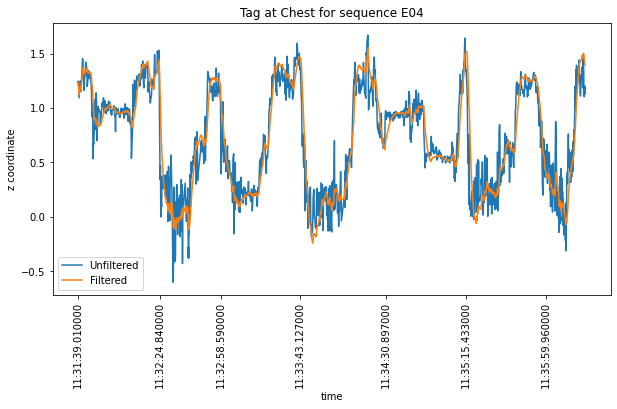

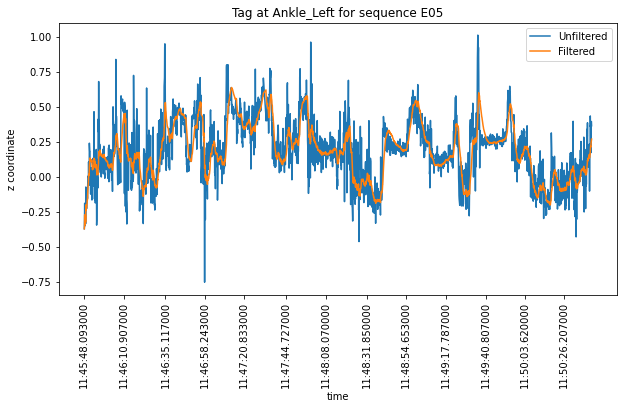

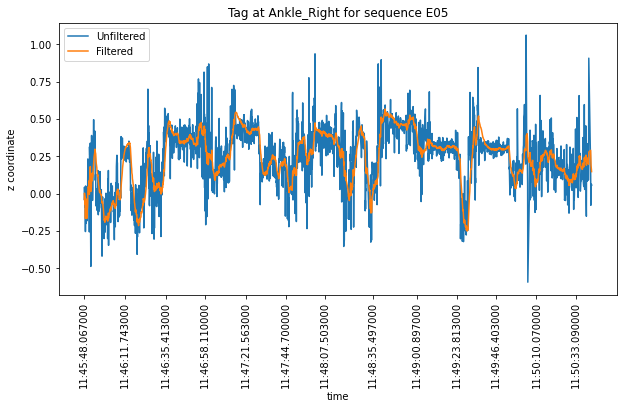

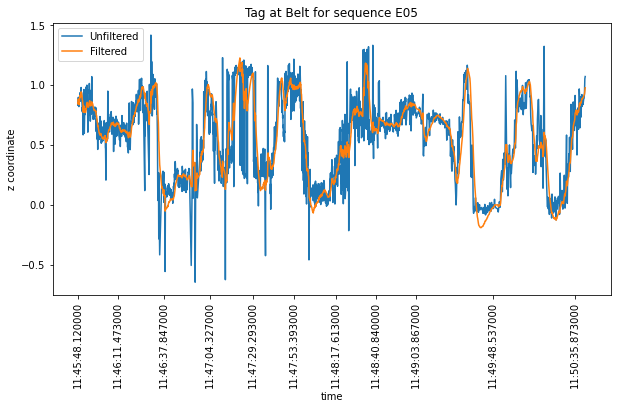

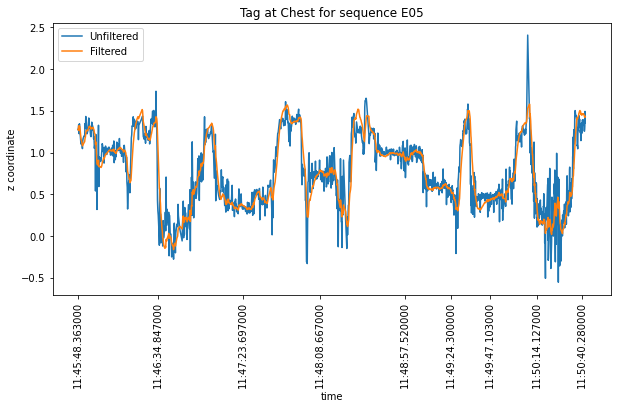

In [18]:
#Plotting the unfiltered and filtered data z coordinate
for i in df_clean.sequence_name.unique():
    for j in df_clean.tag_position.unique():
        plt.subplots(figsize=(10, 5))
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').z_coord, label='Unfiltered')
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').z_coord_filtered, label='Filtered')
        _ = plt.xlabel('time')
        _ = plt.ylabel('z coordinate')
        _ = plt.title(label=('Tag at '+j+' for sequence '+i))
        xt = df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date[::200]
        xtl = xt.dt.strftime('%H:%M:%S.%f')
        _ = plt.xticks(xt, xtl, rotation=90)
        _ = plt.legend()
        plt.show()

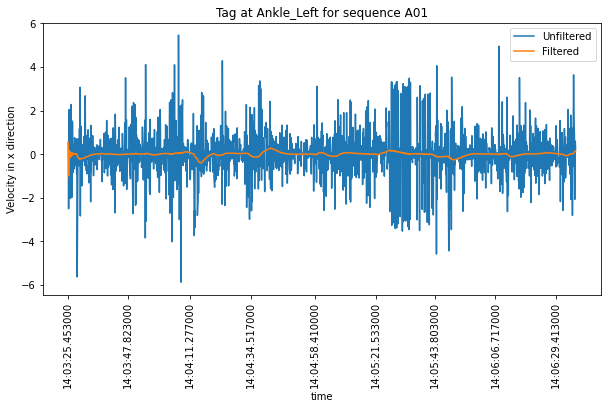

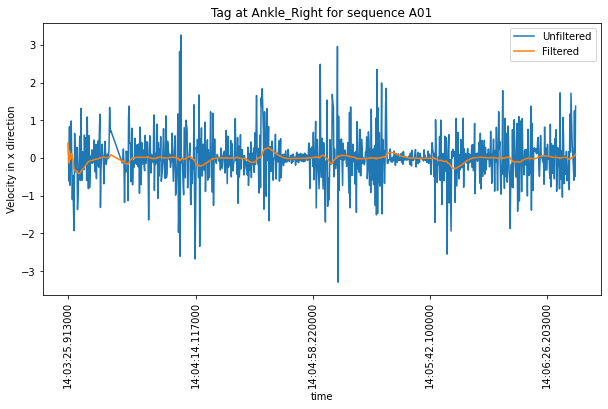

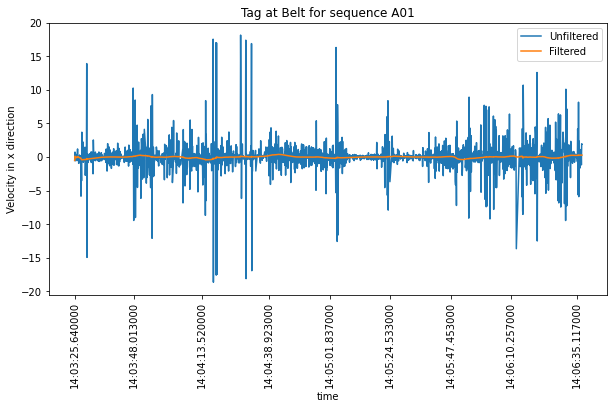

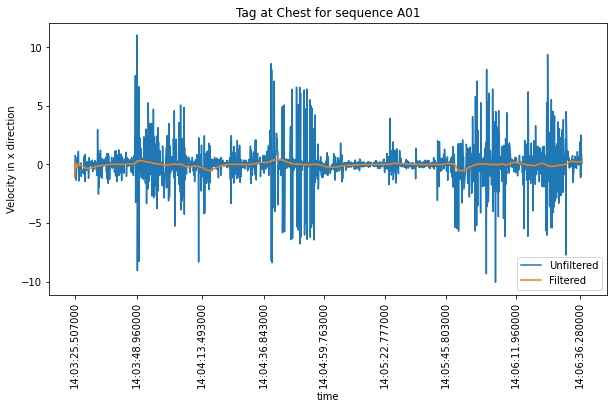

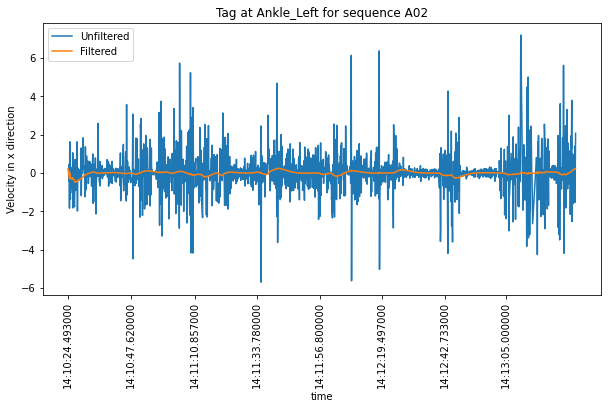

...

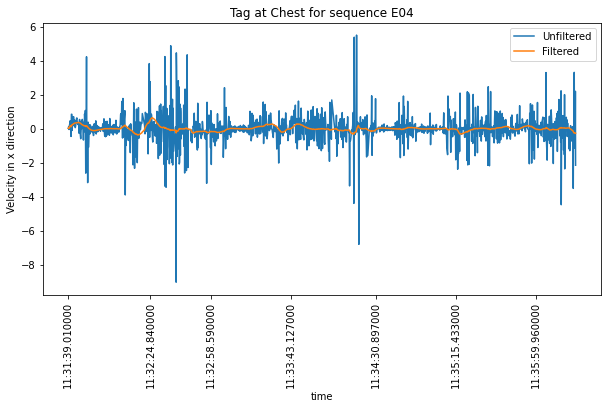

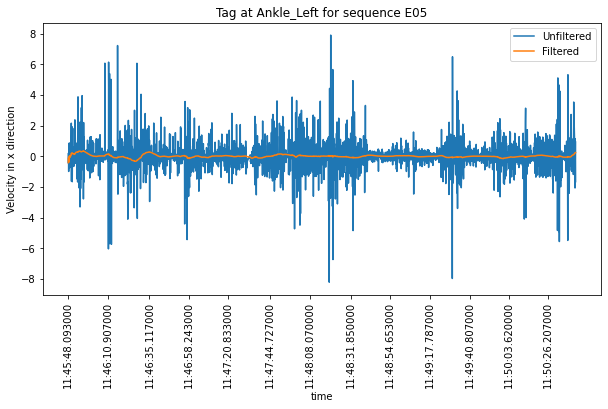

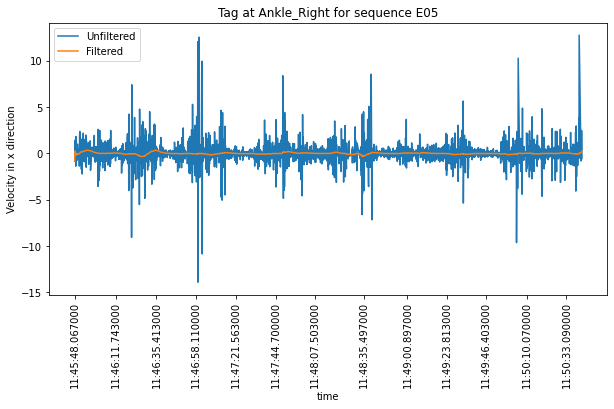

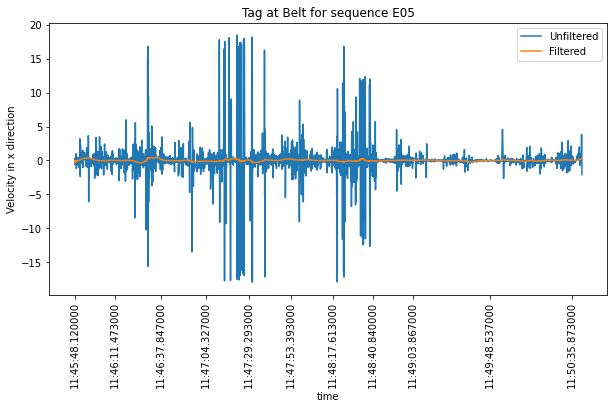

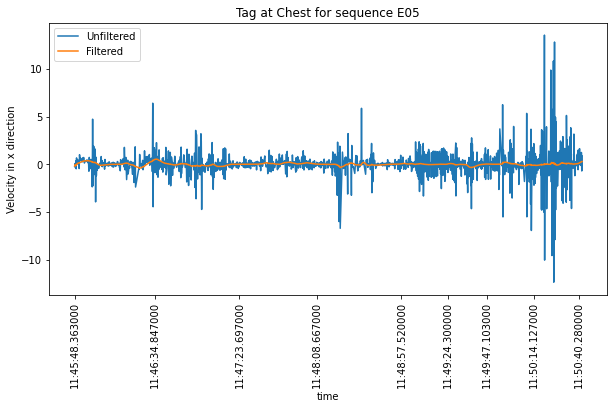

In [19]:
#Plotting the unfiltered and filtered data vx
for i in df_clean.sequence_name.unique():
    for j in df_clean.tag_position.unique():
        plt.subplots(figsize=(10, 5))
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').vx, label='Unfiltered')
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').vx_filtered, label='Filtered')
        _ = plt.xlabel('time')
        _ = plt.ylabel('Velocity in x direction')
        _ = plt.title(label=('Tag at '+j+' for sequence '+i))
        xt = df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date[::200]
        xtl = xt.dt.strftime('%H:%M:%S.%f')
        _ = plt.xticks(xt, xtl, rotation=90)
        _ = plt.legend()
        plt.show()

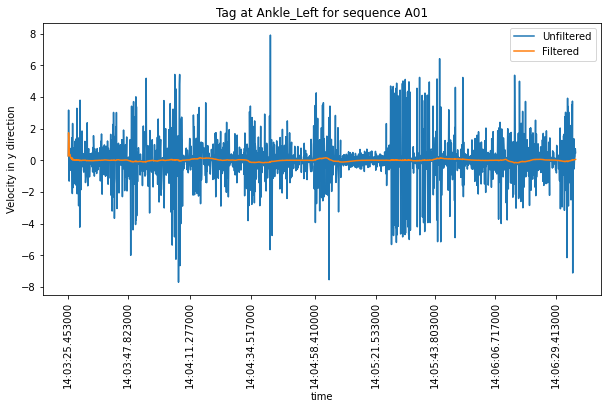

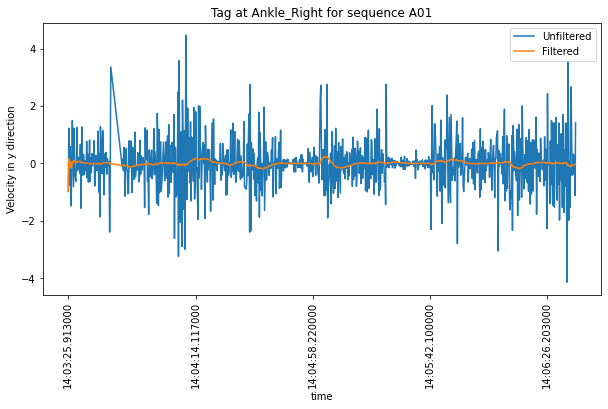

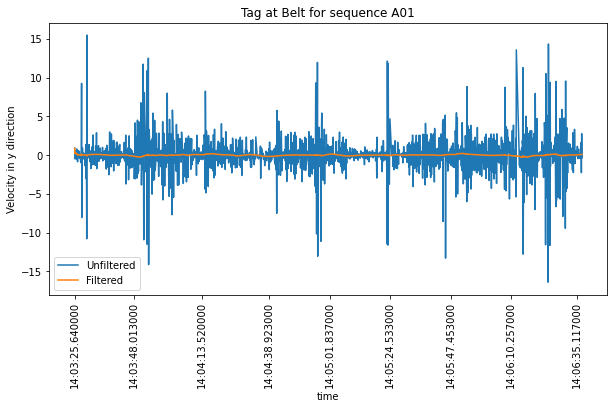

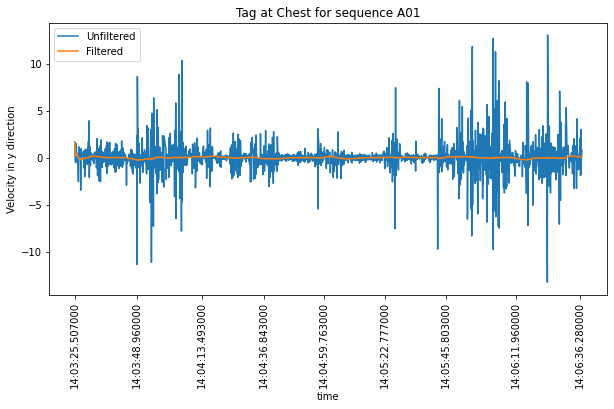

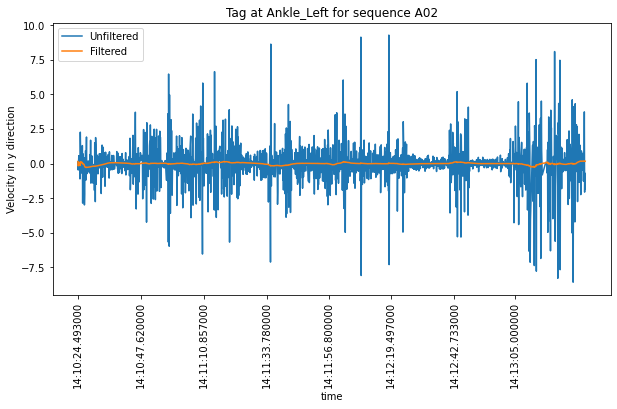

...

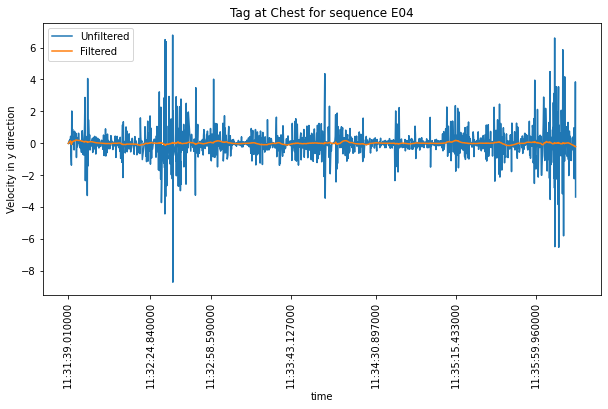

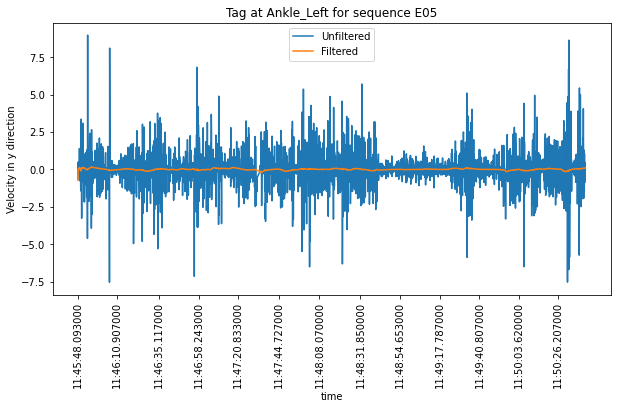

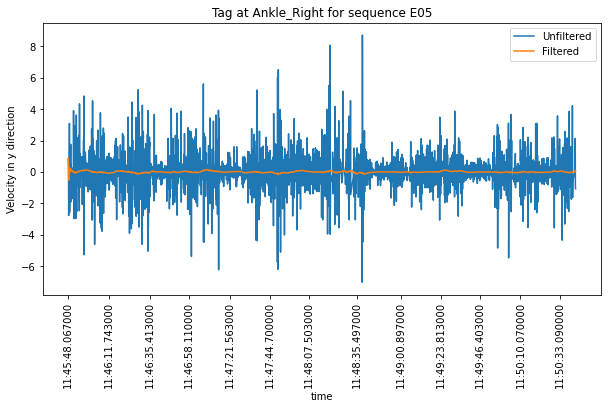

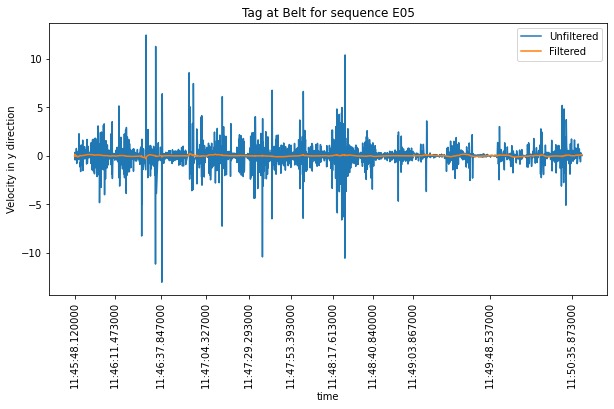

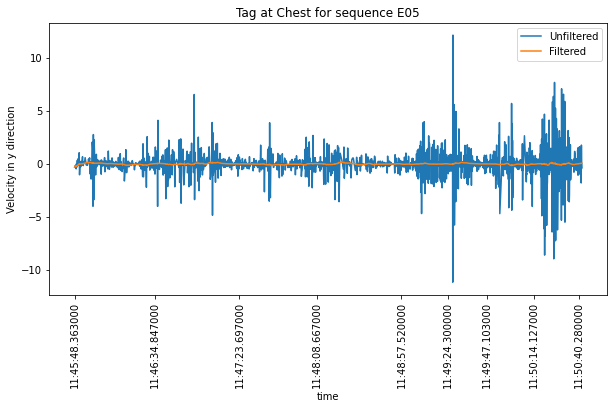

In [20]:
#Plotting the unfiltered and filtered data vy
for i in df_clean.sequence_name.unique():
    for j in df_clean.tag_position.unique():
        plt.subplots(figsize=(10, 5))
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').vy, label='Unfiltered')
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').vy_filtered, label='Filtered')
        _ = plt.xlabel('time')
        _ = plt.ylabel('Velocity in y direction')
        _ = plt.title(label=('Tag at '+j+' for sequence '+i))
        xt = df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date[::200]
        xtl = xt.dt.strftime('%H:%M:%S.%f')
        _ = plt.xticks(xt, xtl, rotation=90)
        _ = plt.legend()
        plt.show()

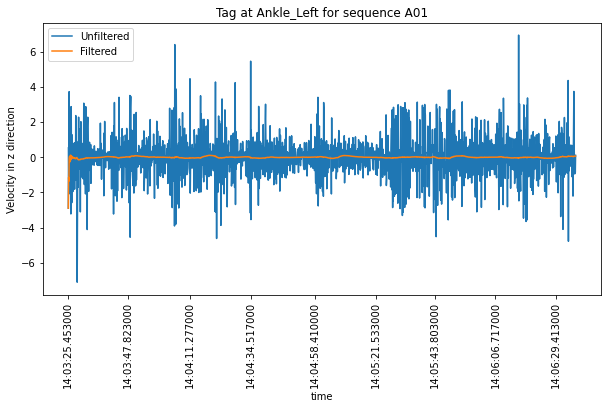

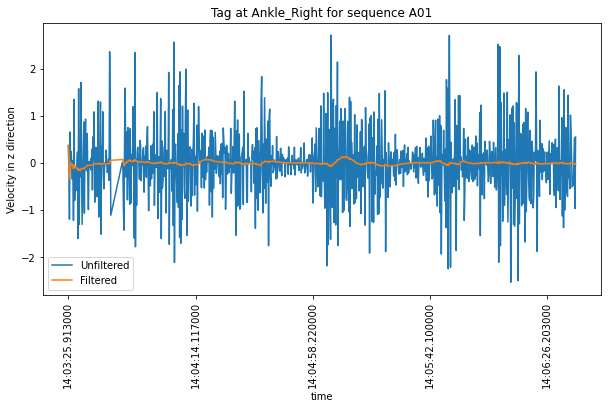

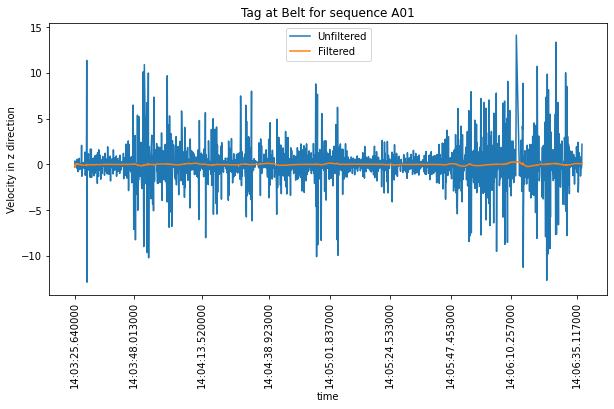

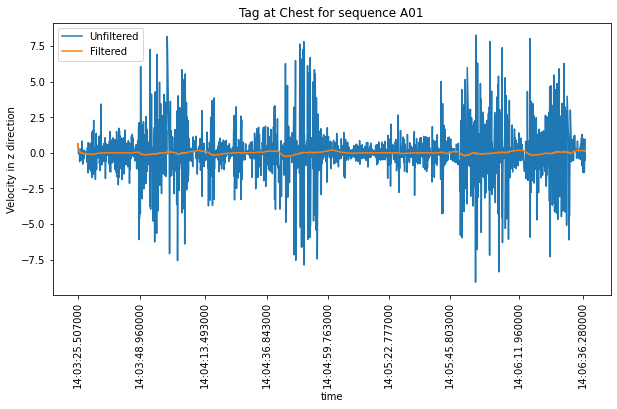

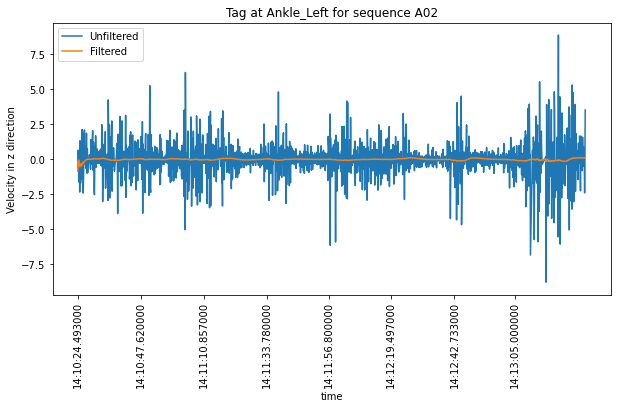

...

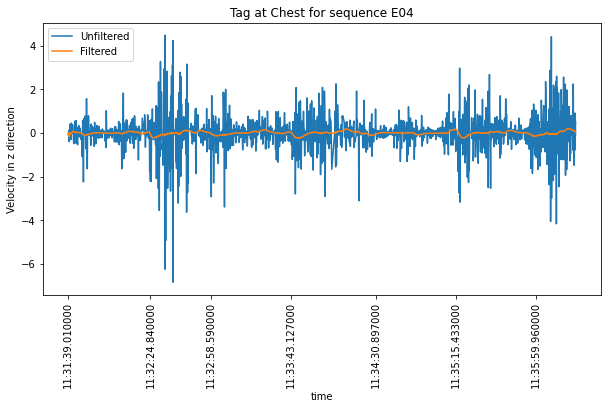

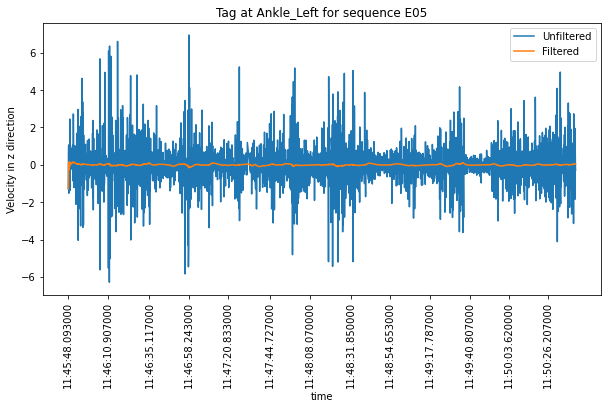

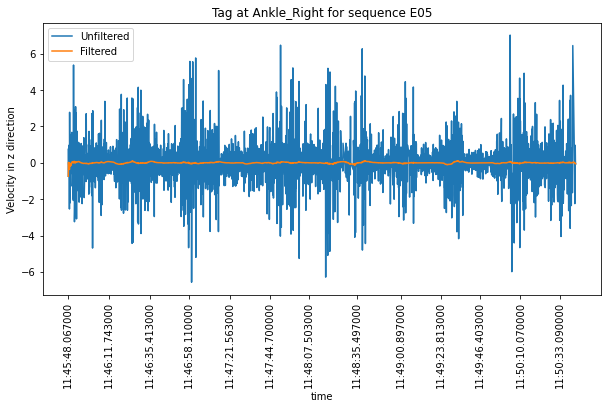

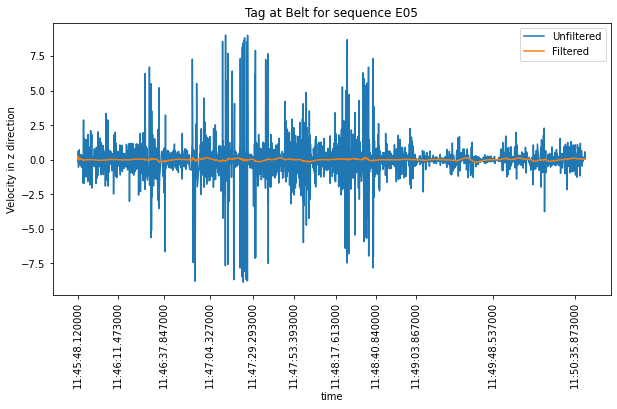

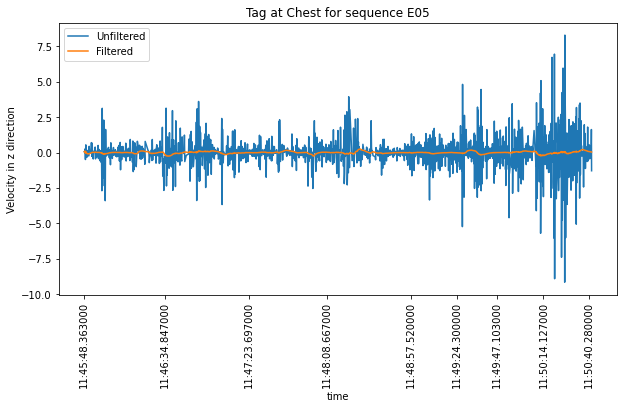

In [21]:
#Plotting the unfiltered and filtered data vz
for i in df_clean.sequence_name.unique():
    for j in df_clean.tag_position.unique():
        plt.subplots(figsize=(10, 5))
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').vz, label='Unfiltered')
        _ = plt.plot(df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date, df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').vz_filtered, label='Filtered')
        _ = plt.xlabel('time')
        _ = plt.ylabel('Velocity in z direction')
        _ = plt.title(label=('Tag at '+j+' for sequence '+i))
        xt = df_clean[(df_clean['tag_position']==j) & (df_clean['sequence_name']==i)].sort_values('date').date[::200]
        xtl = xt.dt.strftime('%H:%M:%S.%f')
        _ = plt.xticks(xt, xtl, rotation=90)
        _ = plt.legend()
        plt.show()